# Omni→Image Retrieval: Мультимодальный поиск изображений

В этом ноутбуке реализуется система омни-поиска изображений из датасета WikiArt (5000 изображений).

Так как в предыдущих ноутбуках я показывала создание поиска по картинке и по тексту с указанием стиля и автора, в данном ноутбуке реализован поиск по изображению и описанию с жанром, автором и цветовой гаммой

In [1]:
# Установка необходимых библиотек
!pip install -q datasets torch torchvision transformers open-clip-torch faiss-cpu pillow numpy pandas matplotlib tqdm huggingface-hub sentence-transformers bitsandbytes accelerate


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 16.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 31.4/31.4 MB 38.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.4/59.4 MB 9.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 2.5 MB/s eta 0:00:00


In [2]:
!pip install -U bitsandbytes

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
import torch
from transformers import AutoProcessor, AutoModel, Blip2ForConditionalGeneration, BitsAndBytesConfig
from datasets import load_dataset
import faiss
from tqdm.auto import tqdm
from sentence_transformers import SentenceTransformer
import requests
import io
import warnings
warnings.filterwarnings('ignore')

np.random.seed(42)
torch.manual_seed(42)

device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Device: {device}")


Device: cuda


## Загрузка датасета

In [4]:
dataset = load_dataset("lyubachuba/wikiart_5k", split="train")

README.md: 0.00B [00:00, ?B/s]

data/train-00000-of-00005.parquet:   0%|          | 0.00/403M [00:00<?, ?B/s]

data/train-00001-of-00005.parquet:   0%|          | 0.00/422M [00:00<?, ?B/s]

data/train-00002-of-00005.parquet:   0%|          | 0.00/405M [00:00<?, ?B/s]

data/train-00003-of-00005.parquet:   0%|          | 0.00/413M [00:00<?, ?B/s]

data/train-00004-of-00005.parquet:   0%|          | 0.00/421M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/5000 [00:00<?, ? examples/s]

## Генерация zero-shot признаков

Как и в случае с созданием подписей, воспользуюсь BLIP-2, генерирую только 1 признак - цветовую гамму, так как инференс очень долгий

In [5]:
import torch
from transformers import AutoProcessor, Blip2ForConditionalGeneration, BitsAndBytesConfig

blip_model_name = "Salesforce/blip2-opt-2.7b"

quantization_config = BitsAndBytesConfig(
    load_in_4bit=True,
    bnb_4bit_compute_dtype=torch.float16,
    bnb_4bit_quant_type="nf4"
)

blip_processor = AutoProcessor.from_pretrained(blip_model_name)
blip_model = Blip2ForConditionalGeneration.from_pretrained(
    blip_model_name,
    quantization_config=quantization_config,
    device_map={"": 0}
)

processor_config.json:   0%|          | 0.00/68.0 [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


preprocessor_config.json:   0%|          | 0.00/432 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/882 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

added_tokens.json:   0%|          | 0.00/23.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/548 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

model.safetensors.index.json: 0.00B [00:00, ?B/s]

Fetching 2 files:   0%|          | 0/2 [00:00<?, ?it/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/10.0G [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/4.98G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/141 [00:00<?, ?B/s]

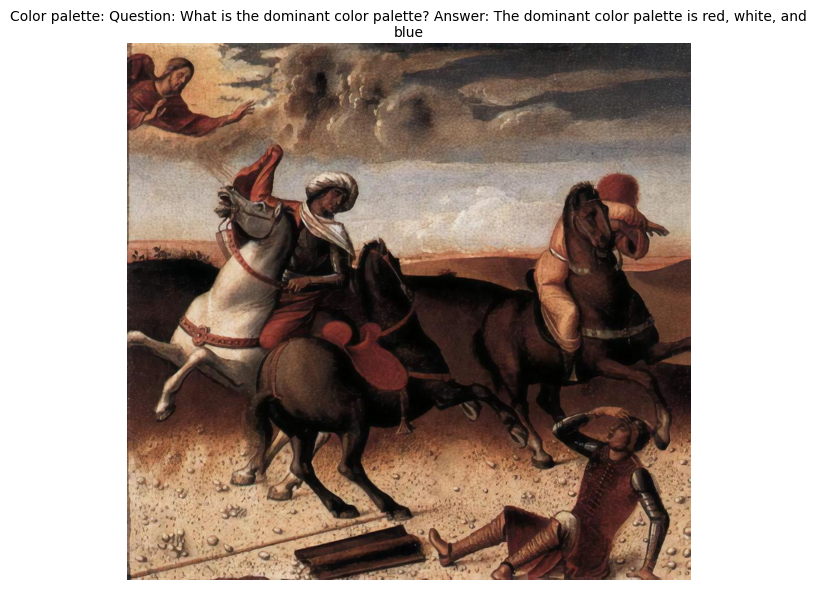

In [11]:
def generate_color_palette(image, processor, model, device, prompt="Question: What is the dominant color palette? Answer:", max_length=80, num_beams=2):

    inputs = processor(images=image, text=prompt, return_tensors="pt").to(device, model.dtype)

    with torch.no_grad():
        output_ids = model.generate(
            **inputs,
            max_length=max_length,
            num_beams=num_beams,
            early_stopping=True
        )

    caption = processor.batch_decode(output_ids, skip_special_tokens=True)[0].strip()

    return caption


example_image = dataset[0]['image']
example_caption = generate_color_palette(example_image, blip_processor, blip_model, device)

plt.figure(figsize=(8, 6))
plt.imshow(example_image)
plt.title(f"Color palette: {example_caption}", fontsize=10, wrap=True)
plt.axis('off')
plt.tight_layout()
plt.show()

In [12]:
import random

num_examples = 10
example_indices = random.sample([i for i in range(len(dataset))], 10)

example_captions = []

for idx in tqdm(example_indices):
    image = dataset[int(idx)]['image']
    caption = generate_color_palette(image, blip_processor, blip_model, device)
    example_captions.append({
        'index': int(idx),
        'image': image,
        'color_palette': caption
    })

  0%|          | 0/10 [00:00<?, ?it/s]

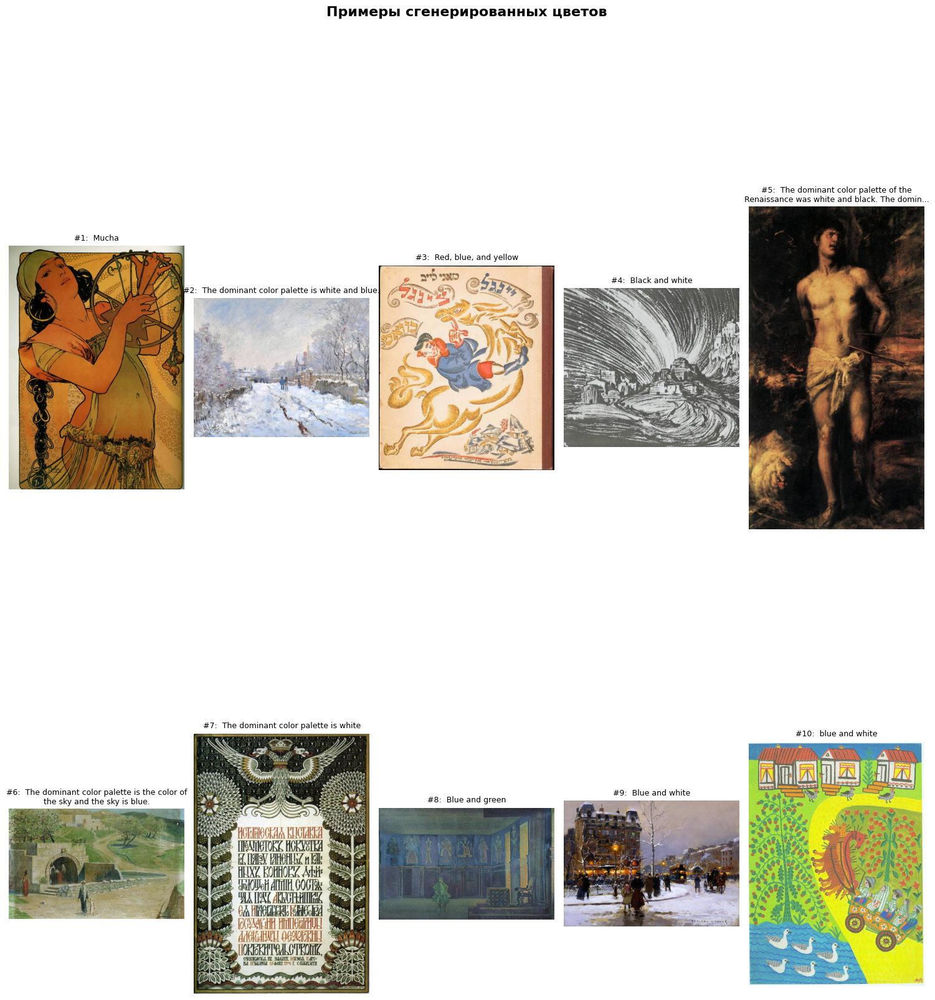

In [14]:
fig, axes = plt.subplots(2, 5, figsize=(15, 20))
fig.suptitle('Примеры сгенерированных цветов', fontsize=16, fontweight='bold')

for i, (ax, example) in enumerate(zip(axes.flat, example_captions)):
    ax.imshow(example['image'])
    caption_text = example['color_palette'].replace("Question: What is the dominant color palette? Answer:", "")
    if len(caption_text) > 80:
        caption_text = caption_text[:77] + '...'
    ax.set_title(f"#{i+1}: {caption_text}", fontsize=9, wrap=True)
    ax.axis('off')

plt.tight_layout()
plt.show()

## Генерация для всего датасета

In [15]:
from datasets import Dataset
from huggingface_hub import notebook_login

notebook_login()

In [16]:
all_captions = []
batch_size = 8

for i in tqdm(range(0, len(dataset), batch_size)):
    batch_end = min(i + batch_size, len(dataset))
    batch_images = [dataset[j]['image'] for j in range(i, batch_end)]

    for image in batch_images:
        caption = generate_color_palette(image, blip_processor, blip_model, device)
        all_captions.append(caption)

print(f"Примеры описаний:")
for i in range(5):
  print(f"{i+1}. {all_captions[i]}")


dataset_to_hf = [
    {
        'image_id': i,
        'color_palette': all_captions[i]
    } for i in range(len(all_captions))
]

dataset_to_hf = pd.DataFrame(dataset_to_hf)
dataset_to_hf = Dataset.from_pandas(dataset_to_hf)

dataset_to_hf.push_to_hub("lyubachuba/wikiart_5k_colors")

  0%|          | 0/625 [00:00<?, ?it/s]

Примеры описаний:
1. Question: What is the dominant color palette? Answer: The dominant color palette is red, white, and blue
2. Question: What is the dominant color palette? Answer: Blue and green
3. Question: What is the dominant color palette? Answer: The dominant color palette is red, yellow, and orange.
4. Question: What is the dominant color palette? Answer: The dominant color palette is the color of the sky.
5. Question: What is the dominant color palette? Answer: The dominant color palette is a combination of blues, greens, and browns.


Uploading the dataset shards:   0%|          | 0/1 [00:00<?, ? shards/s]

Creating parquet from Arrow format:   0%|          | 0/5 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              : 100%|##########| 57.8kB / 57.8kB            

CommitInfo(commit_url='https://huggingface.co/datasets/lyubachuba/wikiart_5k_colors/commit/1af23338b098a3ec19ef8521ff99d348c01685be', commit_message='Upload dataset', commit_description='', oid='1af23338b098a3ec19ef8521ff99d348c01685be', pr_url=None, repo_url=RepoUrl('https://huggingface.co/datasets/lyubachuba/wikiart_5k_colors', endpoint='https://huggingface.co', repo_type='dataset', repo_id='lyubachuba/wikiart_5k_colors'), pr_revision=None, pr_num=None)

## Построение нового текстового индекса с учетом цветовой гаммы

  0%|          | 0/5000 [00:00<?, ?it/s]

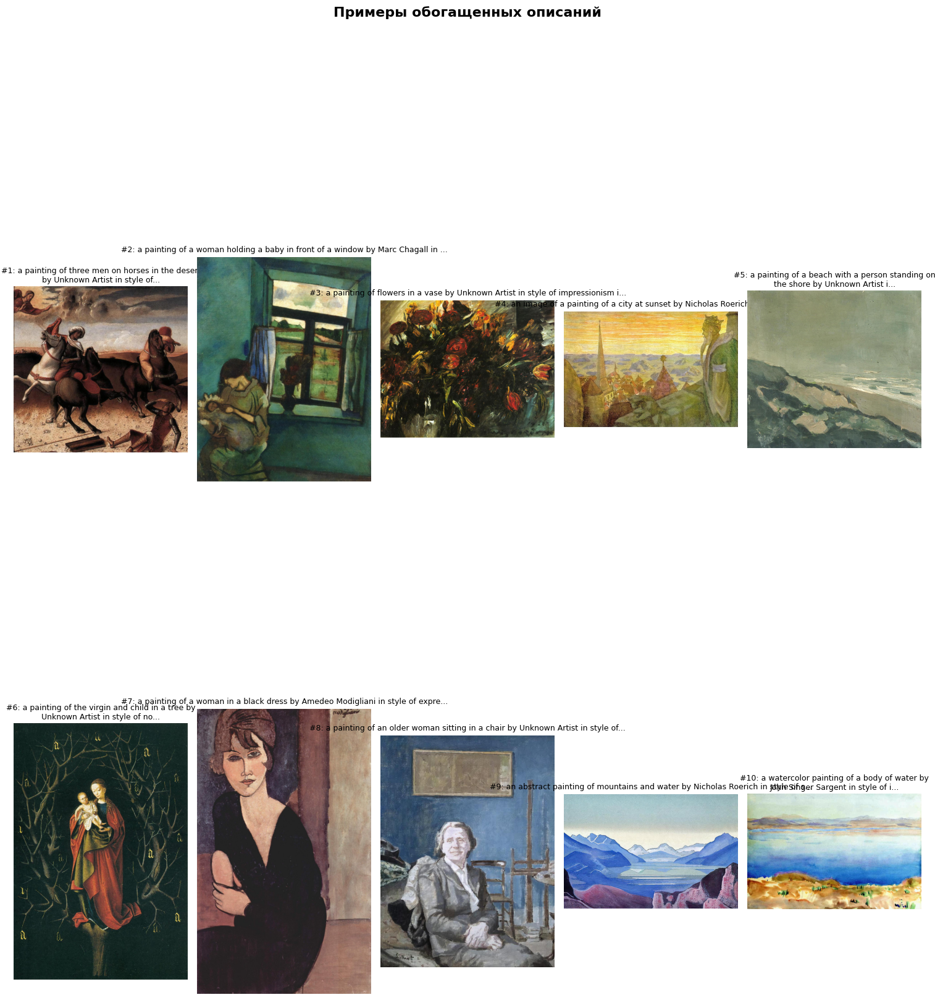

In [17]:
# строю новый текстовый индекс с учетом цветовой гаммы

dataset = load_dataset("lyubachuba/wikiart_5k", split='train')
captions = load_dataset("lyubachuba/wikiart_5k_captions", split='train')
colors = load_dataset("lyubachuba/wikiart_5k_colors", split='train')

# хочу обогатить кэпшны информацией о стиле и художнике

artists = dataset.features['artist'].names
styles = dataset.features['style'].names
genres = dataset.features['genre'].names

extra_info_captions = []

for i in tqdm(range(len(dataset))):
    base_caption = captions[i]['caption']

    artist = " ".join([elem.title() for elem in artists[dataset[i]['artist']].split("-")])
    style = " ".join([elem.lower() for elem in styles[dataset[i]['style']].split("_")])
    genre = " ".join([elem.lower() for elem in styles[dataset[i]['genre']].split("_")])

    color_palette = colors[i]["color_palette"].replace("The dominant color palette is ", "").lower().replace("question: what is the dominant color palette? answer:", "")

    extra_info_captions.append(f"{base_caption} by {artist} in style of {style} in {genre} genre. Color palette: {color_palette}".replace("  ", " "))

dataset = dataset.add_column('enriched_caption', extra_info_captions)

fig, axes = plt.subplots(2, 5, figsize=(15, 20))
fig.suptitle('Примеры обогащенных описаний', fontsize=16, fontweight='bold')

for i, (ax, example) in enumerate(zip(axes.flat, dataset)):
    ax.imshow(example['image'])
    caption_text = example['enriched_caption']
    if len(caption_text) > 80:
        caption_text = caption_text[:77] + '...'
    ax.set_title(f"#{i+1}: {caption_text}", fontsize=9, wrap=True)
    ax.axis('off')

plt.tight_layout()
plt.show()

In [18]:
# не умещается на плоте, вывожу 5 кэпшнов
import random

for idx in random.sample([i for i in range(len(dataset))], 5):
  print(f"{idx}. {dataset[idx]['enriched_caption']}")

4927. a painting of three people sitting on the grass by Pierre Auguste Renoir in style of impressionism in analytical cubism genre. Color palette: the dominant color palette of the impressionist movement was red, blue, and yellow.
4149. black and white drawing of trees in a park by Ivan Shishkin in style of realism in baroque genre. Color palette: black and white
3186. a painting of a man in a fur coat by Unknown Artist in style of realism in fauvism genre. Color palette: white and black
2261. a painting of an old building with stairs by Gustave Caillebotte in style of impressionism in action painting genre. Color palette: white and gray
4793. a drawing of a woman holding a book by Edward Burne Jones in style of symbolism in cubism genre. Color palette: red, white, and blue


In [19]:
sentence_encoder = SentenceTransformer('all-mpnet-base-v2', device=device)

caption_embeddings = sentence_encoder.encode(
    extra_info_captions,
    batch_size=32,
    show_progress_bar=True,
    convert_to_numpy=True
)

# нормализация для косинусного сходства
caption_embeddings = caption_embeddings / np.linalg.norm(
    caption_embeddings, axis=1, keepdims=True
)

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md: 0.00B [00:00, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/571 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/438M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/363 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/239 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Batches:   0%|          | 0/157 [00:00<?, ?it/s]

In [20]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [21]:
dimension = caption_embeddings.shape[1]
M = 32  # количество соседей

index = faiss.IndexHNSWFlat(dimension, M, faiss.METRIC_INNER_PRODUCT)
index.hnsw.efConstruction = 40
index.hnsw.efSearch = 16

index.add(caption_embeddings)

index_path = "/content/drive/MyDrive/MM_HW1/enriched_caption_index.bin"
faiss.write_index(index, index_path)

## Поиск с учетом нескольких модальностей и параметров

Использую здесь индексы и функции из предыдущего задания

In [25]:
# ------- КАРТИНКИ -------

def download_image(url):
  try:
    response = requests.get(url, stream=True, timeout=10)
    response.raise_for_status()

    image_data = response.content
    pil_image = Image.open(io.BytesIO(image_data))

    if pil_image.mode != 'RGB':
        pil_image = pil_image.convert('RGB')

    return pil_image

  except Exception as e:
    return None

def get_image_embedding(image, model, processor, device):
    inputs = processor(images=image, return_tensors="pt").to(device, model.dtype)

    with torch.no_grad():
        embedding = model.get_image_features(**inputs)
        embedding /= embedding.norm(dim=-1, keepdim=True)

    return embedding.cpu().numpy()

def search_similar_images(query_image, index, model,  processor, device, top_k=5):

    query_embedding = get_image_embedding(query_image, model, processor, device)
    distances, indices = index.search(query_embedding.astype('float32'), top_k)

    return distances[0], indices[0]

# ------- ТЕКСТЫ -------

def search_similar_captions(query, sentence_processor, index, top_k=10):

    query_embedding = sentence_processor.encode([query], convert_to_numpy=True)
    query_embedding = query_embedding / np.linalg.norm(query_embedding, axis=1, keepdims=True)

    distances, indices = index.search(query_embedding.astype('float32'), top_k)

    return distances[0], indices[0]

In [ ]:
model_name = "google/siglip2-base-patch16-224"

siglip_processor = AutoProcessor.from_pretrained(model_name)
siglip_model = AutoModel.from_pretrained(model_name, dtype=torch.float16).to(device)
siglip_model.eval()


image_index = faiss.read_index("/content/drive/MyDrive/MM_HW1/image_index.bin")
text_index = faiss.read_index("/content/drive/MyDrive/MM_HW1/enriched_caption_index.bin")

preprocessor_config.json:   0%|          | 0.00/394 [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


tokenizer_config.json: 0.00B [00:00, ?B/s]

tokenizer.model:   0%|          | 0.00/4.24M [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/34.4M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/636 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/253 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.50G [00:00<?, ?B/s]

In [52]:
def combined_search(


    dataset,
    image_index,
    text_index,
    siglip_model,
    siglip_processor,
    sentence_encoder,
    device,

    query_image_url = None,
    query_text = None,


    top_k  = 10,
    weights = {'image': 0.5, 'text': 0.5}
):

    len_dataset = len(dataset)
    scores = np.zeros(len(dataset))

    # поиск по картинке
    if query_image_url is not None and weights.get('image', 0) > 0:
        query_image = download_image(query_image_url)
        distances, indices = search_similar_images(query_image, image_index, siglip_model, siglip_processor, device, len_dataset)
        for i, (idx, dist) in enumerate(zip(indices, distances)):
            scores[idx] += weights['image'] * dist

    # Поиск по тексту
    if query_text is not None and weights.get('text', 0) > 0:
        distances, indices = search_similar_captions(query_text, sentence_encoder, text_index, len_dataset)
        for i, (idx, dist) in enumerate(zip(indices, distances)):
            scores[idx] += weights['text'] * dist

    sorted_indices = np.argsort(scores)[::-1]
    filtered_indices = [idx for idx in sorted_indices if scores[idx] > 0]

    return filtered_indices[:top_k]


In [42]:
import math

def display_results(
    indices,
    dataset,
    query_text=None,
    query_image_url=None,
):
    if not indices:
        print("Ничего не найдено.")
        return

    if query_image_url:
        query_image = download_image(query_image_url)
        if query_image:
            plt.figure(figsize=(4, 4))
            title = "Запрос:"
            if query_text:
                title += f'\nТекст: "{query_text}"'

            plt.imshow(query_image)
            plt.title(title)
            plt.axis('off')
            plt.show()
    elif query_text:
        print(f'Результаты по текстовому запросу: "{query_text}"')

    num_results = len(indices)
    cols = 4
    rows = math.ceil(num_results / cols)

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, rows * 4.5))
    axes = axes.flatten()

    for i, idx in enumerate(indices):
        try:
            image = dataset[int(idx)]['image']
            caption = dataset[int(idx)]['enriched_caption']

            if image:
                ax = axes[i]
                ax.imshow(image)
                ax.set_title(f"{caption[:80]}...", fontsize=5)
                ax.axis('off')

        except Exception as e:
          pass

    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    fig.suptitle("Результаты поиска", fontsize=16)
    plt.show()

## Пример 1

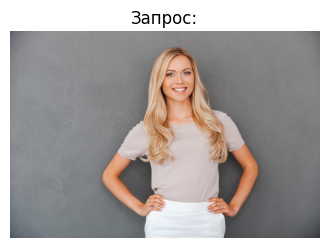

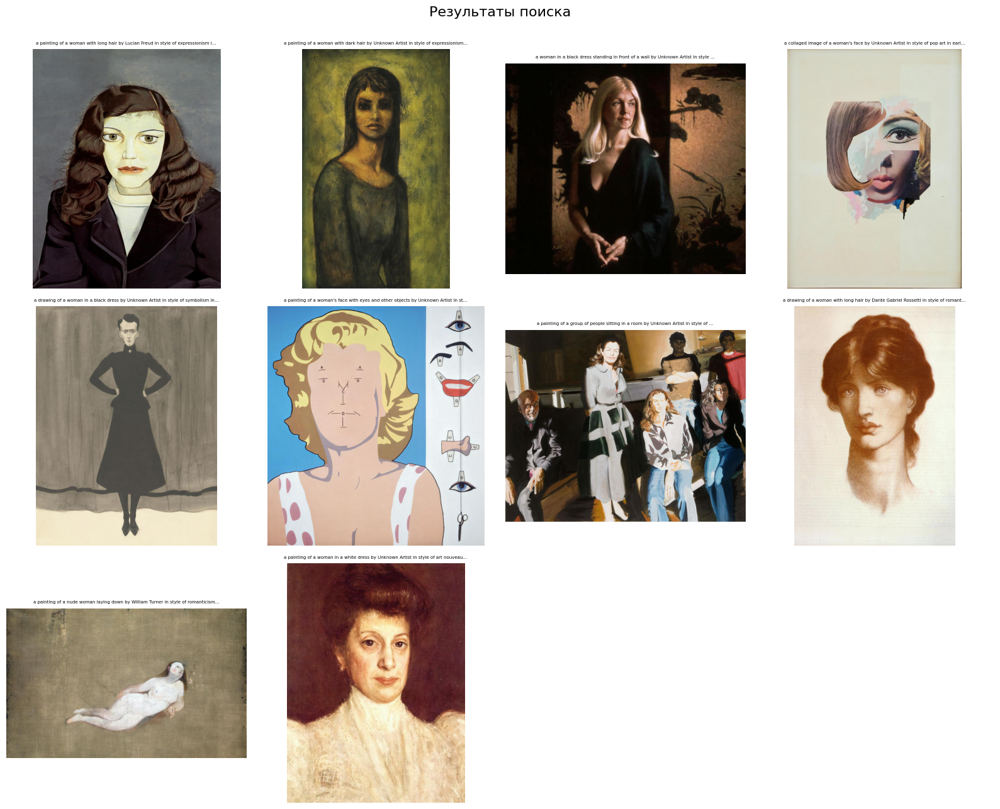

In [53]:
# image only
query_image_url = "https://www.collegefashion.net/wp-content/uploads/2021/02/confident-woman-1.png" # just a woman

found_indices = combined_search(
                                  dataset,
                                  image_index,
                                  text_index,
                                  siglip_model,
                                  siglip_processor,
                                  sentence_encoder,
                                  device,

                                  query_image_url = query_image_url
                              )
display_results(
    found_indices,
    dataset,
    query_image_url=query_image_url
)

Результаты по текстовому запросу: "Korovin"


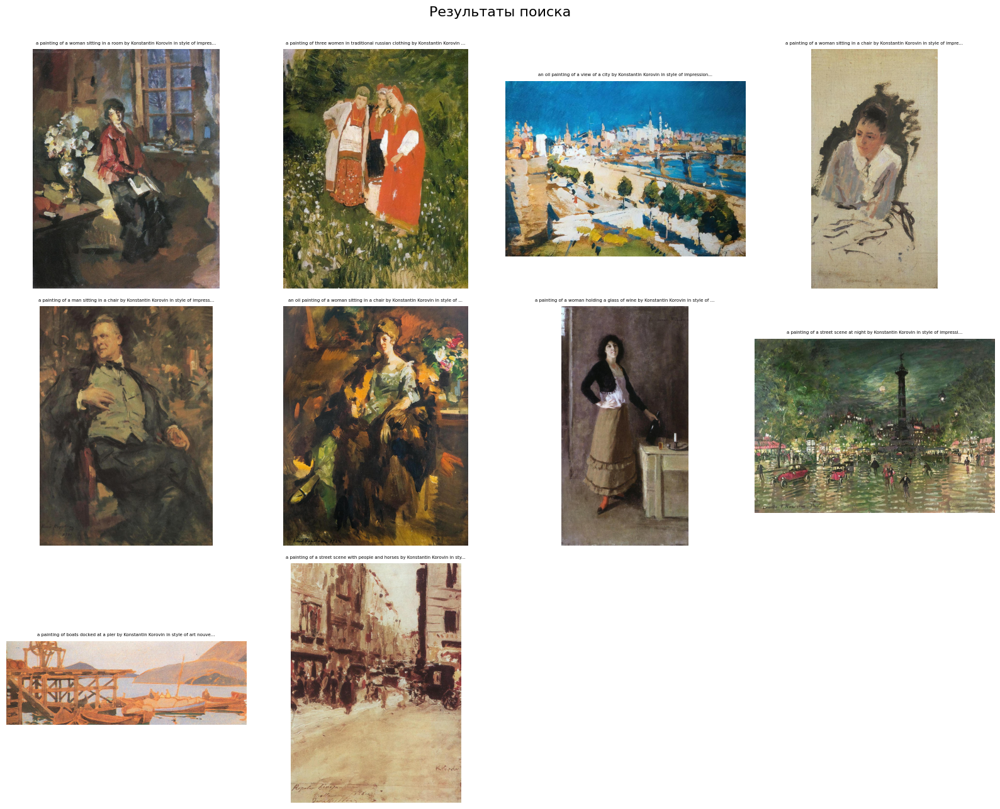

In [59]:
# text only
query_text = "Korovin"

found_indices = combined_search(
                                  dataset,
                                  image_index,
                                  text_index,
                                  siglip_model,
                                  siglip_processor,
                                  sentence_encoder,
                                  device,
                                  query_text = query_text
                              )
display_results(
    found_indices,
    dataset,
    query_text=query_text
)

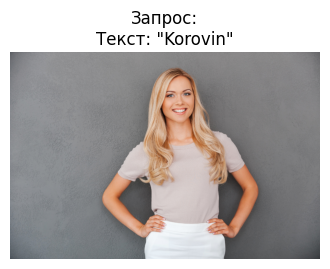

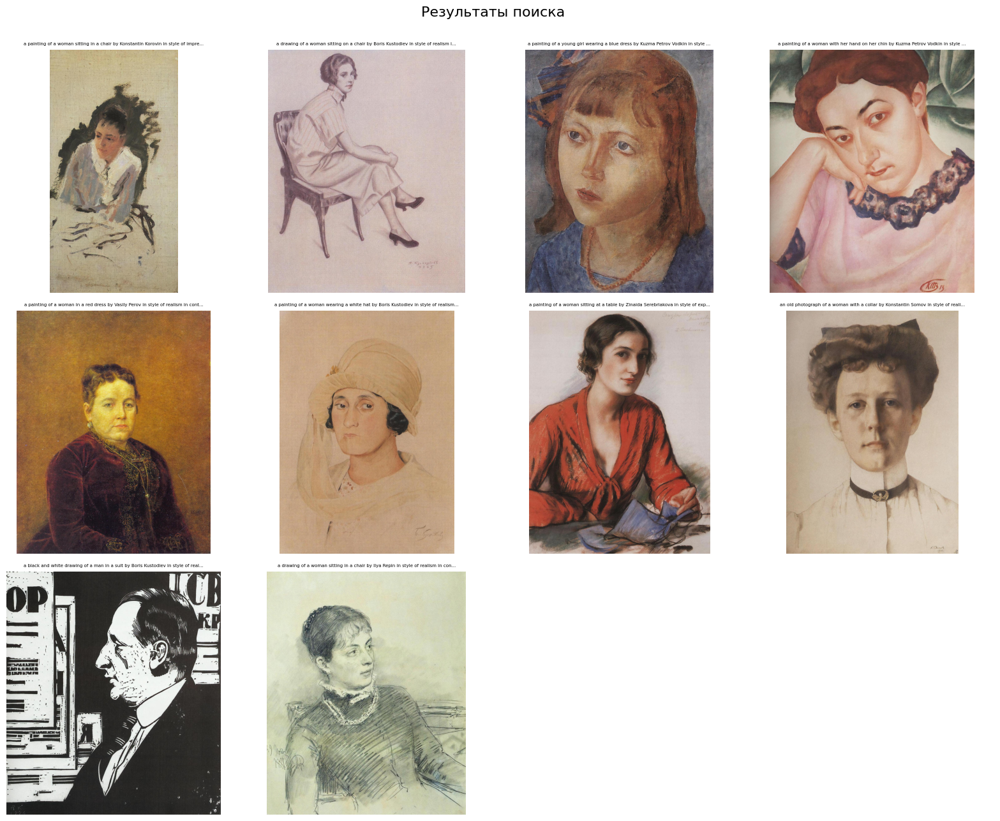

In [60]:
# text and image

query_image_url = "https://www.collegefashion.net/wp-content/uploads/2021/02/confident-woman-1.png" # just a woman
query_text = "Korovin"

found_indices = combined_search(
                                  dataset,
                                  image_index,
                                  text_index,
                                  siglip_model,
                                  siglip_processor,
                                  sentence_encoder,
                                  device,
                                  query_text = query_text,
                                  query_image_url = query_image_url,
                                  weights = {'image': 0.5, 'text': 0.5}
                              )
display_results(
    found_indices,
    dataset,
    query_text=query_text,
    query_image_url = query_image_url
)

# в результате изображения женщин нарисованные русскими художниками-передвижниками

## Пример 2

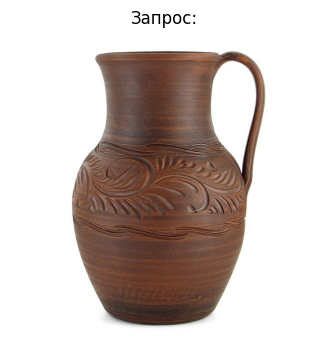

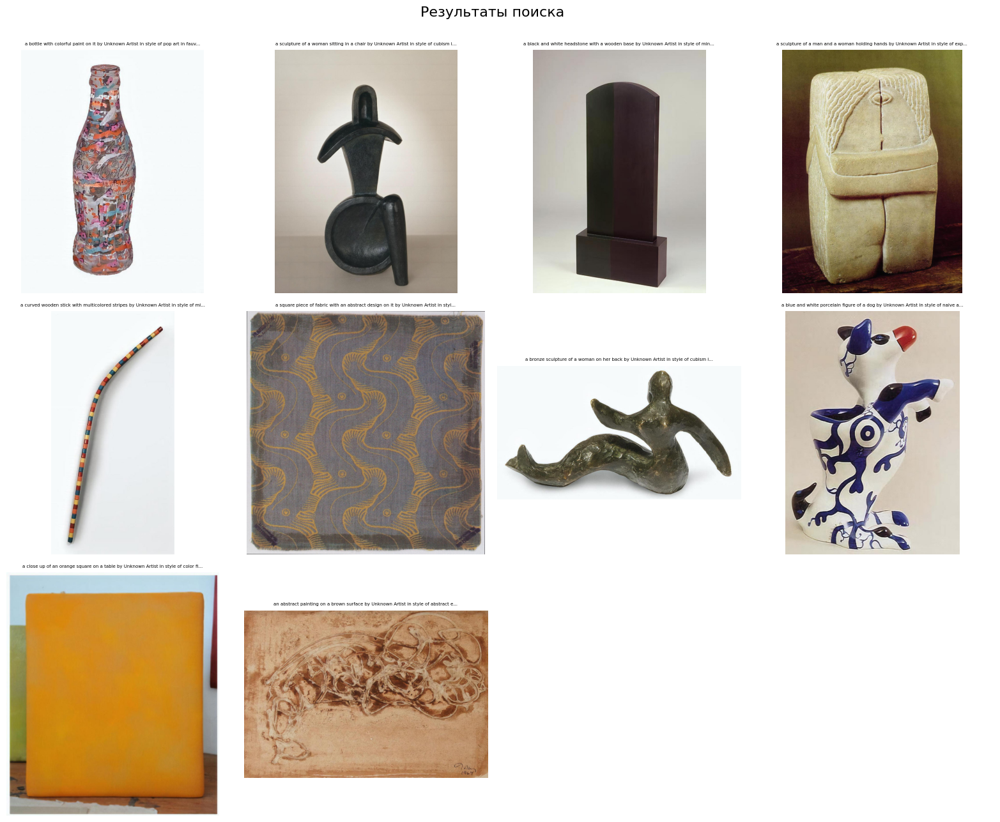

In [67]:
# image only
query_image_url = "https://fsd.multiurok.ru/html/2022/03/21/s_6238045a55513/phpFriZqp_igra-Puteshestvie-Keramushki_html_74a752e0a7dfe615.jpg" # кувшин

found_indices = combined_search(
                                  dataset,
                                  image_index,
                                  text_index,
                                  siglip_model,
                                  siglip_processor,
                                  sentence_encoder,
                                  device,

                                  query_image_url = query_image_url
                              )
display_results(
    found_indices,
    dataset,
    query_image_url=query_image_url
)

Результаты по текстовому запросу: "color palette is black"


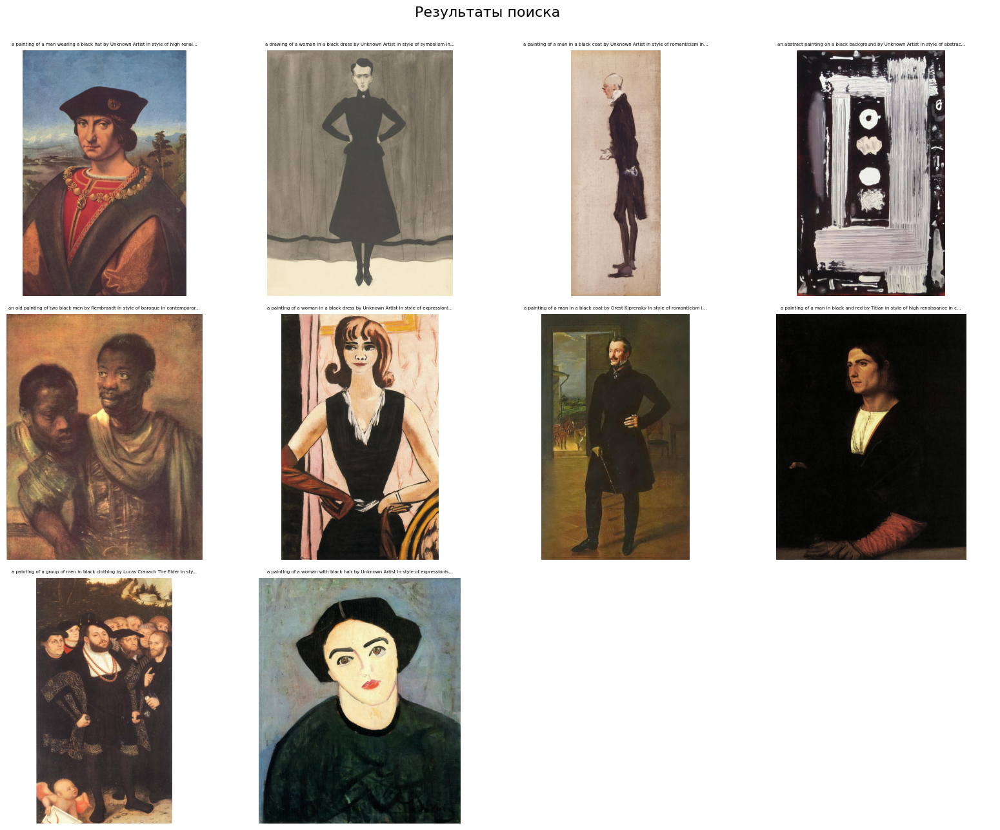

In [73]:
# text only
query_text = "color palette is black"

found_indices = combined_search(
                                  dataset,
                                  image_index,
                                  text_index,
                                  siglip_model,
                                  siglip_processor,
                                  sentence_encoder,
                                  device,
                                  query_text = query_text
                              )
display_results(
    found_indices,
    dataset,
    query_text=query_text
)

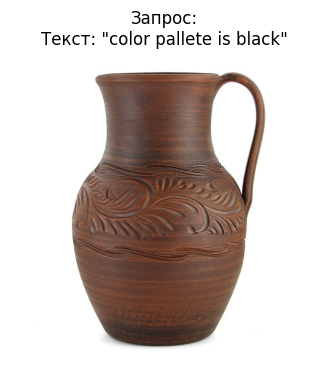

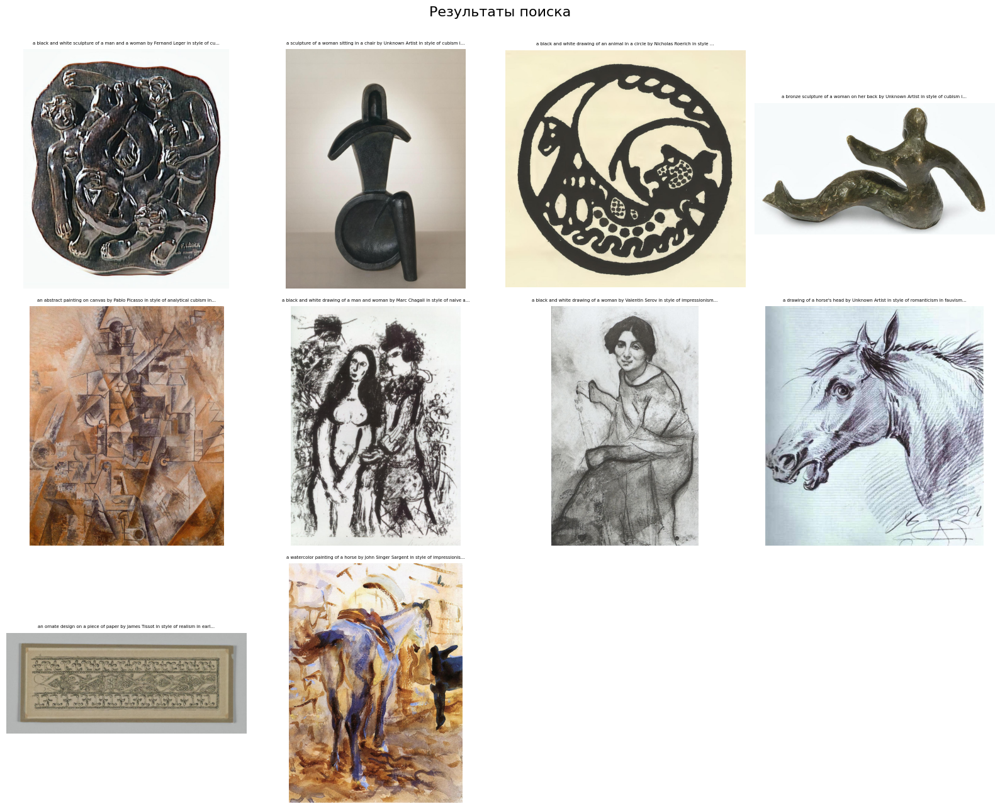

In [75]:
# text and image

query_image_url = "https://fsd.multiurok.ru/html/2022/03/21/s_6238045a55513/phpFriZqp_igra-Puteshestvie-Keramushki_html_74a752e0a7dfe615.jpg"
query_text = "color pallete is black"

found_indices = combined_search(
                                  dataset,
                                  image_index,
                                  text_index,
                                  siglip_model,
                                  siglip_processor,
                                  sentence_encoder,
                                  device,
                                  query_text = query_text,
                                  query_image_url = query_image_url,
                                  weights = {'image': 0.5, 'text': 0.3}
                              )
display_results(
    found_indices,
    dataset,
    query_text=query_text,
    query_image_url = query_image_url
)

# в результате черные глиняные изделия